In [24]:
import pandas as pd
import numpy as np
import altair as alt

alt.renderers.enable('notebook')
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

In [25]:
df = pd.read_csv("pitchfork.csv")
df.head()

,artist,album,genre,primary,score,date,author,role
0,David Byrne,“…The Best Live Show of All Time” — NME EP,Rock,Rock,5.5,2019-01-11,Andy Beta,Contributor
1,DJ Healer,Lost Lovesongs / Lostsongs Vol. 2,Electronic,Electronic,6.2,2019-01-11,Chal Ravens,Contributor
2,Jorge Velez,Roman Birds,Electronic,Electronic,7.9,2019-01-10,Philip Sherburne,Contributing Editor
3,Chandra,Transportation EPs,Rock,Rock,7.8,2019-01-10,Andy Beta,Contributor
4,The Chainsmokers,Sick Boy,Electronic,Electronic,3.1,2019-01-09,Larry Fitzmaurice,Contributor


- Relation between number of reviews and average score by primary genre and year
- 10 best bands/artists by score
- Number / distribution of reviews with score equals or above 8 by primary genre
- Number / distribution of reviews with score equals or below 2 by primary genre
- Genre's rank (by number of reviews) and it's number of reviews by year

### Relation between number of reviews and average score by primary genre and year

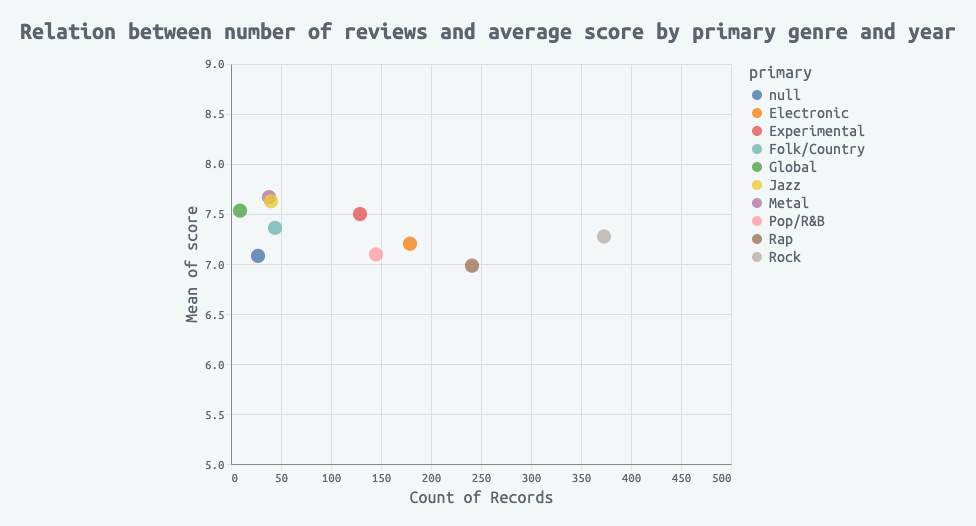

In [311]:
slider = alt.binding_range(
    min=1999, 
    max=2019, 
    step=1, 
    name='year:'
)
slider_selection = alt.selection_single(
    name="year_selector", 
    fields=['year'],
    bind=slider, 
    init={'year': 2018}
)

alt.Chart(df).mark_circle().encode(
    x = alt.X('score', aggregate='count', scale = alt.Scale(zero = False, domain=[0,500])),
    y = alt.Y('score', aggregate='mean', scale = alt.Scale(zero = False, domain=[5,9])),
    color = 'primary',
    opacity=alt.value(0.8),
    size = alt.value(200),
    tooltip = alt.Tooltip(['primary', 'count()', 'mean(score)'])
).transform_calculate(
    year = 'year(datum.date)'
).add_selection(
    slider_selection
).transform_filter(
    slider_selection
).configure(
    background="#F3F7F7",
    padding={"left": 20, "top": 20, "right": 20, "bottom": 20}
).configure_axis(
    labelColor="#5D646F",
    labelFontSize=13,
    labelFont="Ubuntu Mono",
    titleFont="Ubuntu Mono",
    tickColor="lightGray",
    tickDash=[1,1],
    titleFontWeight = "normal",
    titleFontSize=18,
    titleColor="#5D646F",
    #domainColor="#F3F7F7",
).configure_title(
    dx=7,
    dy=-10,
    fontSize=24,
    color="#5D646F",
    font = "Ubuntu Mono"
).configure_legend(
    titleFontWeight = "normal",
    titleFontSize=18,
    titleColor="#5D646F",
    titleFont="Ubuntu Mono",
    
    labelFontWeight = "normal",
    labelFontSize=16,
    labelColor="#5D646F",
    labelFont="Ubuntu Mono",
    
).properties(
    width = 500, 
    height = 400, 
    title="Relation between number of reviews and average score by primary genre and year"
)

### 10 best bands/artists by score

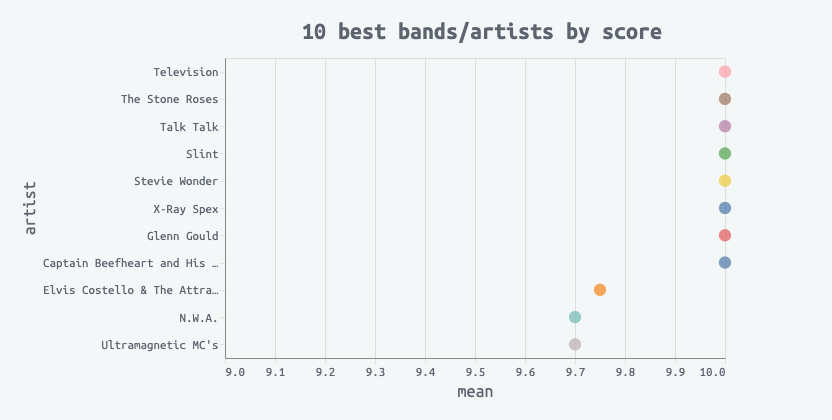

In [329]:
alt.Chart(df).transform_aggregate(
    mean='mean(score)',
    groupby=['artist']
).transform_window(
    rank='rank(mean)',
    sort=[alt.SortField('mean', order='descending')]
).transform_filter(
    alt.datum.rank <= 10
).mark_circle(size=150).encode(
    y=alt.Y('artist:N', sort = alt.Sort(field = 'mean', order='descending')),
    x=alt.X('mean:Q', scale = alt.Scale(zero = False, domain=[9,10])),
    color = alt.Color('artist:N', legend=None),
    tooltip = alt.Tooltip(['artist'])
).configure(
    background="#F3F7F7",
    padding={"left": 20, "top": 20, "right": 100, "bottom": 20}
).configure_axis(
    labelColor="#5D646F",
    labelFontSize=13,
    labelFont="Ubuntu Mono",
    titleFont="Ubuntu Mono",
    tickColor="lightGray",
    tickDash=[1,1],
    titleFontWeight = "normal",
    titleFontSize=18,
    titleColor="#5D646F",
).configure_title(
    dx=7,
    dy=-10,
    fontSize=24,
    color="#5D646F",
    font = "Ubuntu Mono"
).properties(
    width = 500, 
    height = 300, 
    title="10 best bands/artists by score"
)

### Number / distribution of reviews with score equals or above 8 by primary genre

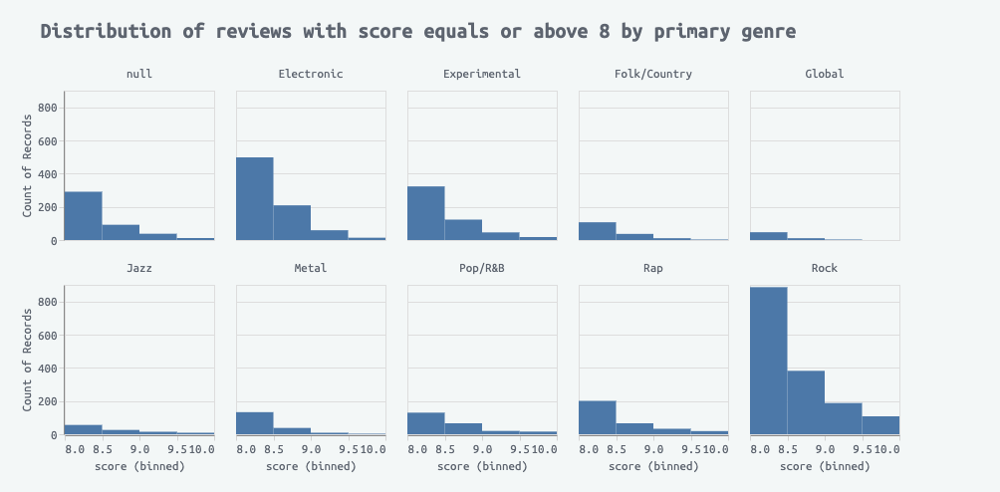

In [339]:
alt.Chart(df).transform_filter(
    'datum.score >= 8'
).mark_rect().encode(
    x = alt.X('score:Q', bin = alt.Bin(step = 0.5)),
    y = alt.Y('count()'),
    tooltip = alt.Tooltip(['count()'])
).properties(width = 150, height = 150, ).facet('primary:O', columns = 5, title ="Distribution of reviews with score equals or above 8 by primary genre"
).configure(
    background="#F3F7F7",
    padding={"left": 20, "top": 20, "right": 100, "bottom": 20},
    header={"titleFont": "Ubuntu Mono",
            "titleFontSize": 0,
            "labelFont": "Ubuntu Mono",
            "labelFontSize": 13,
            "titleColor":"#5D646F",
            "labelColor": "#5D646F"
           }
).configure_axis(
    labelColor="#5D646F",
    labelFontSize=13,
    labelFont="Ubuntu Mono",
    titleFont="Ubuntu Mono",
    tickColor="lightGray",
    titleFontWeight = "normal",
    titleFontSize=13,
    titleColor="#5D646F",
).configure_title(
    dx=20,
    dy=-10,
    fontSize=22,
    color="#5D646F",
    font = "Ubuntu Mono"
)

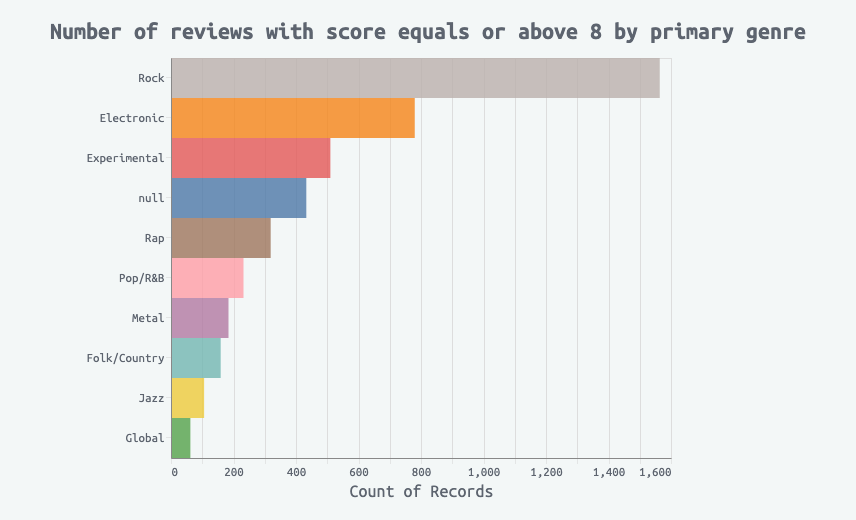

In [338]:
alt.Chart(df).mark_rect().transform_filter(
    'datum.score >= 8'
).encode(
    x = alt.X('score', aggregate='count', scale = alt.Scale(zero = False)),
    y = alt.Y('primary', sort=alt.EncodingSortField(
            field="primary", op="count",  order="descending"  
        )),

    color = alt.Color('primary', legend=None),
    opacity=alt.value(0.8),
    tooltip = alt.Tooltip(['primary', 'count()'])
).configure(
    background="#F3F7F7",
    padding={"left": 50, "top": 20, "right": 50, "bottom": 20}
).configure_axis(
    labelColor="#5D646F",
    labelFontSize=13,
    labelFont="Ubuntu Mono",
    titleFont="Ubuntu Mono",
    tickColor="lightGray",
    tickDash=[1,1],
    titleFontWeight = "normal",
    titleFontSize=18,
    titleColor="#5D646F",
    #domainColor="#F3F7F7",
).configure_title(
    dx=7,
    dy=-10,
    fontSize=24,
    color="#5D646F",
    font = "Ubuntu Mono"
).configure_axisY(
    titleFontSize=0
).properties(
    width = 500, 
    height = 400, 
    title="Number of reviews with score equals or above 8 by primary genre"
)

### Number / distribution of reviews with score equals or below 2 by primary genre

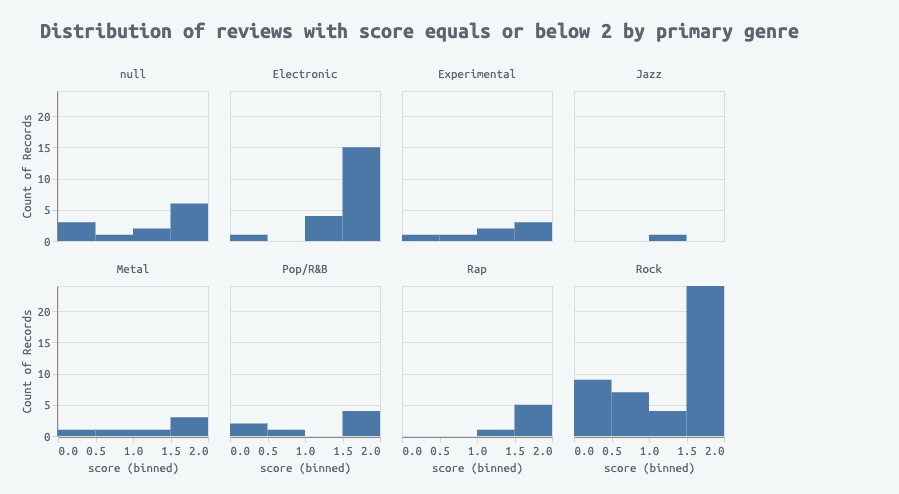

In [340]:
alt.Chart(df).transform_filter(
    'datum.score <= 2'
).mark_rect().encode(
    x = alt.X('score:Q', bin = alt.Bin(step = 0.5)),
    y = alt.Y('count()'),
    tooltip = alt.Tooltip(['count()'])
).properties(width = 150, height = 150).facet('primary:O', columns = 4, title ="Distribution of reviews with score equals or below 2 by primary genre"
).configure(
    background="#F3F7F7",
    padding={"left": 20, "top": 20, "right": 100, "bottom": 20},
    header={"titleFont": "Ubuntu Mono",
            "titleFontSize": 0,
            "labelFont": "Ubuntu Mono",
            "labelFontSize": 13,
            "titleColor":"#5D646F",
            "labelColor": "#5D646F"
           }
).configure_axis(
    labelColor="#5D646F",
    labelFontSize=13,
    labelFont="Ubuntu Mono",
    titleFont="Ubuntu Mono",
    tickColor="lightGray",
    titleFontWeight = "normal",
    titleFontSize=13,
    titleColor="#5D646F",
).configure_title(
    dx=20,
    dy=-10,
    fontSize=22,
    color="#5D646F",
    font = "Ubuntu Mono"
)

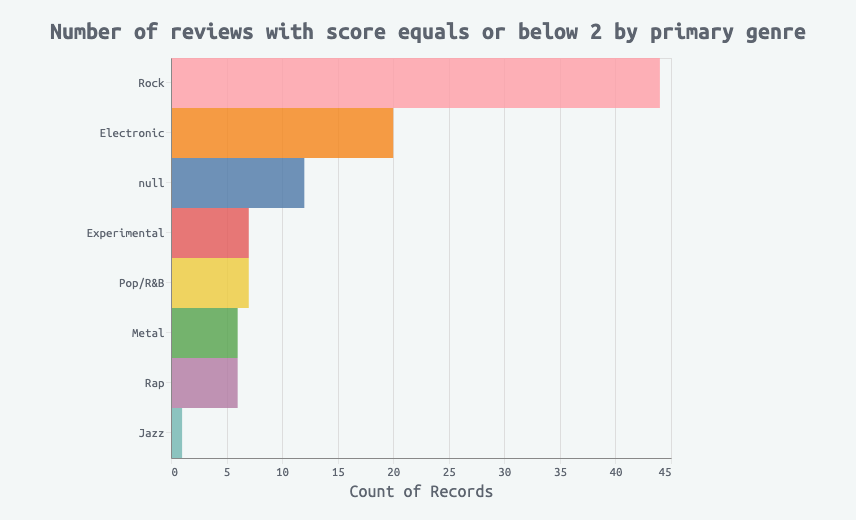

In [337]:
alt.Chart(df).mark_rect().transform_filter(
    'datum.score <= 2'
).encode(
    x = alt.X('score', aggregate='count', scale = alt.Scale(zero = False)),
    y = alt.Y('primary', sort=alt.EncodingSortField(
            field="primary", op="count",  order="descending"  
        )),

    color = alt.Color('primary', legend=None),
    opacity=alt.value(0.8),
    tooltip = alt.Tooltip(['primary', 'count()'])
).configure(
    background="#F3F7F7",
    padding={"left": 50, "top": 20, "right": 50, "bottom": 20}
).configure_axis(
    labelColor="#5D646F",
    labelFontSize=13,
    labelFont="Ubuntu Mono",
    titleFont="Ubuntu Mono",
    tickColor="lightGray",
    tickDash=[1,1],
    titleFontWeight = "normal",
    titleFontSize=18,
    titleColor="#5D646F",
    #domainColor="#F3F7F7",
).configure_title(
    dx=7,
    dy=-10,
    fontSize=24,
    color="#5D646F",
    font = "Ubuntu Mono"
).configure_axisY(
    titleFontSize=0
).properties(
    width = 500, 
    height = 400, 
    title="Number of reviews with score equals or below 2 by primary genre"
)

### Genre's rank (by number of reviews) and it's number of reviews by year

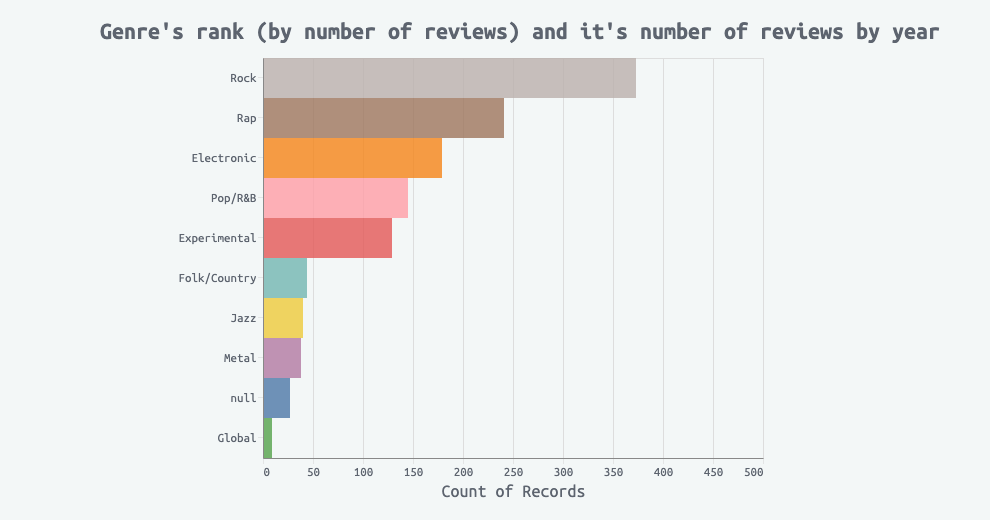

In [336]:
slider = alt.binding_range(
    min=1999, 
    max=2018, 
    step=1, 
    name='year:'
)
slider_selection = alt.selection_single(
    name="year_selector", 
    fields=['year'],
    bind=slider, 
    init={'year': 2018}
)

alt.Chart(df).mark_rect().transform_calculate(
    year = 'year(datum.date)'
).add_selection(
    slider_selection
).transform_filter(
    slider_selection
).encode(
    x = alt.X('score', aggregate='count', scale = alt.Scale(zero = False, domain=[0,500])),
    y = alt.Y('primary', sort=alt.EncodingSortField(
            field="primary", op="count",  order="descending"  
        )),
    #y = alt.Y('score', aggregate='mean', scale = alt.Scale(zero = False, domain=[5,10])),
    color = alt.Color('primary', legend=None),
    opacity=alt.value(0.8),
    size = alt.value(200),
    tooltip = alt.Tooltip(['primary', 'count()'])
).configure(
    background="#F3F7F7",
    padding={"left": 100, "top": 20, "right": 50, "bottom": 20}
).configure_axis(
    labelColor="#5D646F",
    labelFontSize=13,
    labelFont="Ubuntu Mono",
    titleFont="Ubuntu Mono",
    tickColor="lightGray",
    tickDash=[1,1],
    titleFontWeight = "normal",
    titleFontSize=18,
    titleColor="#5D646F",
    #domainColor="#F3F7F7",
).configure_axisY(
    titleFontSize=0
).configure_title(
    dx=7,
    dy=-10,
    fontSize=24,
    color="#5D646F",
    font = "Ubuntu Mono"
).properties(
    width = 500, 
    height = 400, 
    title="Genre's rank (by number of reviews) and it's number of reviews by year"
)